# Проектная работа
# Рынок заведений общественного питания Москвы
_____
**Описание исследования.**
Инвесторы из фонда «Shut Up and Take My Money» решили открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.
    
_____
**Цель исследования.**
Подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.
    
_____
**Задачи исследования.**
Изучить датасет с исходными данными. Выполнить предобработку данных, провести анализ данных датасета, чтобы впоследствии выявить, какие исследования кофеен будут наиболее информативными для решения об открытии новой точки.

1. [**Открытие данных**](#start)
2. [**Предобработка данных**](#preprocessing)
3. [**Анализ данных**](#analysis)
    * [Задача 1](#1) - Количество объектов общественного питания по категориям
    * [Задача 2](#2) - Количество посадочных мест в местах по категориям
    * [Задача 3](#3) - Соотношение сетевых и несетевых заведений
    * [Задача 4](#4) - Топ-15 популярных сетей в Москве
    * [Задача 5](#5) - Общее количество заведений и количество заведений каждой категории по районам
    * [Задача 6](#6) - Распределение средних рейтингов по категориям заведений
    * [Задача 7](#7) - Фоновая картограмма со средним рейтингом заведений каждого района
    * [Задача 8](#8) - Картограмма с кластерами заведений
    * [Задача 9](#9) - Топ-15 улиц по количеству заведений
    * [Задача 10](#10) - Улицы, на которых находится только один объект общепита
    * [Задача 11](#11) - Фоновая картограмма со значениями средних чеков для каждого района
    * [Задача 12](#12) - Выводы
4. [**Открытие кофейни**](#coffee)
    * [1](#c1) - Количество кофеен, районы и особенности расположения
    * [2](#c2) - Круглосуточные кофейни
    * [3](#c3) - Рейтинги и их распределение по районам
    * [4](#c4) - Стоимость чашки капучино
5. [**Презентация**](#presentation)
    

### Открытие данных<a id="start"></a>
**Задача:**
* **Загрузитm данные о заведениях общественного питания Москвы.**
* **Изучить общую информацию о датасете** 
      - Сколько заведений представлено
      - Что можно сказать о каждом столбце
      - Значения какого типа они хранят

**Исходные данные:**

*Файл `moscow_places` содержит датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года.*
<br>В таблице находятся следущие колонки:
- `name` — название заведения
- `address` — адрес заведения
- `category` — категория заведения
- `hours` — информация о днях и часах работы
- `lat` — широта географической точки, в которой находится заведение
- `lng` — долгота географической точки, в которой находится заведение
- `rating` — рейтинг заведения по оценкам пользователей в Яндекс Картах
- `price` — категория цен в заведении
- `avg_bill` — строка, которая хранит среднюю стоимость заказа в виде диапазона
- `middle_avg_bill` — число с оценкой среднего чека, которое указано только для значений из столбца `avg_bill`
- `middle_coffee_cup` — число с оценкой одной чашки капучино, которое указано только для значений из столбца `avg_bill`
- `chain` — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым 
- `district` — административный район, в котором находится заведение
- `seats` — количество посадочных мест

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
from plotly import graph_objects as go
import seaborn as sns
from numpy import median
import folium
from folium import Map, Marker
from folium.plugins import MarkerCluster
from IPython.display import Image

Сохраним данные в переменные, и посмотрим как выглядит таблица с информацией о заведениях.

In [2]:
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

In [3]:
path = 'https://code.s3.yandex.net/datasets/moscow_places.csv'
mp = pd.read_csv(path)
mp.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


Выведем информацию о типе и количестве данных в таблице:

In [4]:
mp.info()
mp.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


(8406, 14)

В таблице почти 8,5тыс. строк. Найдем пропуски в этих данных.

## Предобработка данных<a id="preprocessing"></a>

In [5]:
mp.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

Пропусков с ценами слишком много, если мы как-то будем их заполнять, результаты будут искажены. Пропуски в столбце с временем работы заведений мы не сможем заполнить, как и количество посадочных мест, к тому же пропуск тут может означать что посадочных мест просто нет, например в кофейнях и фастфудных точках с окошком выдачи. 

Напишем функцию, отделяющую названия улиц от адреса, и перенесем их в новую колонку. 

In [6]:
def split(index):
    address = index.split(',')
    return address[1]

mp['street'] = mp['address'].apply(split)

Напишем функцию, выделяющую заведения, работающие круглосуточно, в новой колонке таким заведениям будет присвоено значение True, в остальных случаях - False.

In [7]:
def hour(work):
    try:
        if 'круглосуточно' in work:
            return True
        else:
            return False
    except:
        return False
mp['is_24/7'] = mp['hours'].apply(hour)    

На всякий случай заменим точки и другие знаки, которые могут встретиться в названиях(например, Яндекс.Лавка), на пробелы.

In [8]:
mp['name'] = mp['name'].replace(['.',',','-'], ' ')
mp['name'] = mp['name'].str.lower()

Попробуем найти явные дубликаты.

In [9]:
mp.duplicated().sum()

0

In [10]:
mp[mp.duplicated(['name','address'], keep=False)]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
1430,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"ежедневно, 09:00–21:00",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,0,188.0,Волоколамское шоссе,False
1511,more poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0,Волоколамское шоссе,False
2211,раковарня клешни и хвосты,ресторан,"Москва, проспект Мира, 118",Северо-Восточный административный округ,"ежедневно, 12:00–00:00",55.810553,37.638161,4.4,NaN,NaN,NaN,NaN,0,150.0,проспект Мира,False
2420,раковарня клешни и хвосты,"бар,паб","Москва, проспект Мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.810677,37.638379,4.4,NaN,NaN,NaN,NaN,1,150.0,проспект Мира,False
3091,хлеб да выпечка,булочная,"Москва, Ярцевская улица, 19",Западный административный округ,"ежедневно, 09:00–22:00",55.738886,37.411648,4.1,NaN,NaN,NaN,NaN,1,276.0,Ярцевская улица,False
3109,хлеб да выпечка,кафе,"Москва, Ярцевская улица, 19",Западный административный округ,NaN,55.738449,37.410937,4.1,NaN,NaN,NaN,NaN,0,276.0,Ярцевская улица,False


Появилось три дубликата, такое количество не влияет на результаты, не будем их удалять.

Изменять колонку с названиями районов на сокращенные аббревиатуры не будем, иначе впоследствии исказятся результаты картограммы.

In [11]:
mp.groupby('name')['name'].count().sort_values(ascending=False).head(10)

name
кафе                189
шоколадница         120
домино'с пицца       77
додо пицца           74
one price coffee     72
яндекс лавка         69
cofix                65
prime                50
хинкальная           44
шаурма               43
Name: name, dtype: int64

In [12]:
cafe = mp.query('name == "кафе"')
cafe.head(10)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
40,кафе,кафе,"Москва, Ижорская улица, 18, стр. 1",Северный административный округ,NaN,55.895115,37.524902,3.7,NaN,NaN,NaN,NaN,0,NaN,Ижорская улица,False
47,кафе,кафе,"Москва, улица Маршала Федоренко, 7",Северный административный округ,"ежедневно, 11:00–00:00",55.880306,37.489760,2.8,NaN,NaN,NaN,NaN,0,35.0,улица Маршала Федоренко,False
108,кафе,"бар,паб","Москва, МКАД, 82-й километр, вл18",Северо-Восточный административный округ,NaN,55.908930,37.558777,4.2,NaN,NaN,NaN,NaN,0,NaN,МКАД,False
123,кафе,кафе,"Москва, Шенкурский проезд, 14",Северо-Восточный административный округ,NaN,55.897794,37.591395,4.3,NaN,NaN,NaN,NaN,0,50.0,Шенкурский проезд,False
141,кафе,кафе,"Москва, Дубнинская улица, 52, стр. 1",Северный административный округ,"ежедневно, 10:00–20:00",55.896020,37.556072,3.9,NaN,NaN,NaN,NaN,0,70.0,Дубнинская улица,False
159,кафе,кафе,"Москва, Дмитровское шоссе, 163А",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.908830,37.538790,4.0,NaN,NaN,NaN,NaN,0,NaN,Дмитровское шоссе,False
183,кафе,кафе,"Москва, Алтуфьевское шоссе, 106",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.907607,37.588674,3.2,NaN,NaN,NaN,NaN,0,6.0,Алтуфьевское шоссе,True
189,кафе,кафе,"Москва, парк Ангарские Пруды",Северный административный округ,"ежедневно, 09:00–23:00",55.880327,37.530786,3.2,NaN,NaN,NaN,NaN,0,NaN,парк Ангарские Пруды,False
190,кафе,кафе,"Москва, Алтуфьевское шоссе, 52А",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.878216,37.588239,4.5,NaN,NaN,NaN,NaN,0,NaN,Алтуфьевское шоссе,True
209,кафе,кофейня,"Москва, Алтуфьевское шоссе, 52",Северо-Восточный административный округ,пн-сб 09:00–20:00; вс 09:00–18:00,55.878024,37.587597,4.5,NaN,NaN,NaN,NaN,0,18.0,Алтуфьевское шоссе,False


Много заведений с названиями такого типа как "кафе" и "хинкальная", это все реальные заведения, по какой-то причине не указавшие названия, возможно их просто нет. Можно было бы удалить их, если бы они как-то влияли на подсчет популярных сетей, но они не сетевые. Они могут повлиять на результаты подсчета количества мест по категориям, не будем их удалять.

Найдем и поправим расхождения в некоторых названиях:

In [13]:
mp[mp['name'].str.contains('домино')]['name'].unique() 

array(["домино'с пицца", 'доминос пицца', "домино'с"], dtype=object)

In [14]:
mp['name'] = mp['name'].replace(["домино'с пицца", "домино'с"], 'доминос пицца')

In [15]:
mp[mp['name'].str.contains('шоколадница')]['name'].unique() 

array(['шоколадница', 'торты от сети кофеен шоколадница'], dtype=object)

Тут исправлять не будем, это два разных места.

## Анализ данных<a id="analysis"></a> 

#### Задача 1<a id="1"></a> 
* **Выяснить, какие категории заведений представлены в данных.**
* **Исследовать количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее.**
* **Построить визуализации.**

Посмотрим на список категорий столбца `category`

In [16]:
mp['category'].unique().tolist()

['кафе',
 'ресторан',
 'кофейня',
 'пиццерия',
 'бар,паб',
 'быстрое питание',
 'булочная',
 'столовая']

Выведем количество заведений по категориям с помощью кругового графика, который заодно покажет и их процентное соотноошение.

In [17]:
category = pd.DataFrame(mp['category'].value_counts()).reset_index()
category.columns = ['category', 'count']
category

,category,count
0,кафе,2378
1,ресторан,2043
2,кофейня,1413
3,"бар,паб",765
4,пиццерия,633
5,быстрое питание,603
6,столовая,315
7,булочная,256


In [18]:
fig = px.bar(category.sort_values(by='count'), 
             x='count',
             y='category',
             text='count'
             )
fig.update_layout(title='Количество заведений в Москве по категориям',
                   xaxis_title='Количество заведений',
                   yaxis_title='',
                   legend_title='Категории')
fig.show()

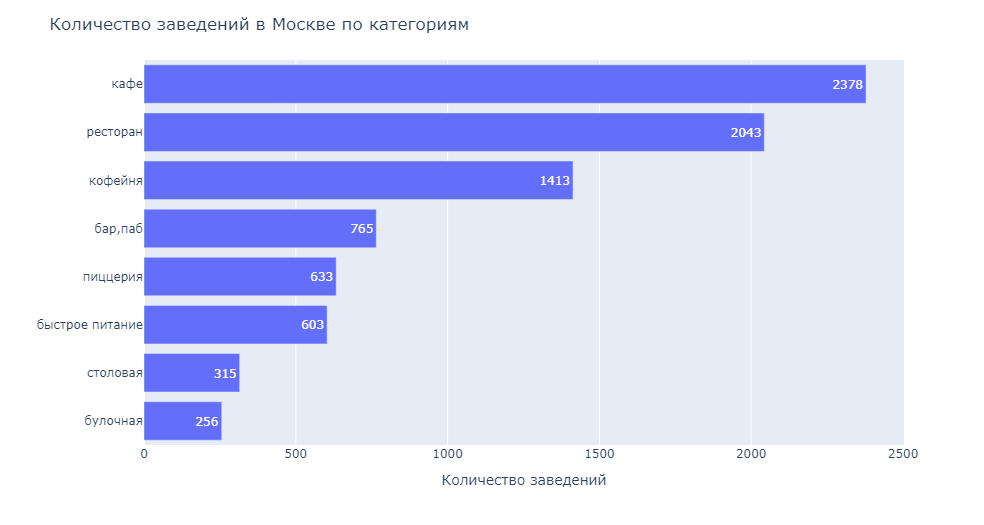

In [19]:
Image(filename='C:\\Users\\admin\\Downloads\\Practicum\\Projects\\6_restaurants_analysis\\newplot(11).png')

<img src=newplot(11).png>

Самое большое количество заведений в Москве относится к категории кафе - 28.3%, далее следуют рестораны и кофейни. На последнем месте столовые(3.75%) и булочные(3.05%).

#### Задача 2<a id="2"></a> 
* **Исследовать количество посадочных мест в местах по категориям: рестораны, кофейни, пиццерии, бары и так далее.**
* **Построить визуализации.**
* **Проанализировать результаты и сделать выводы.**

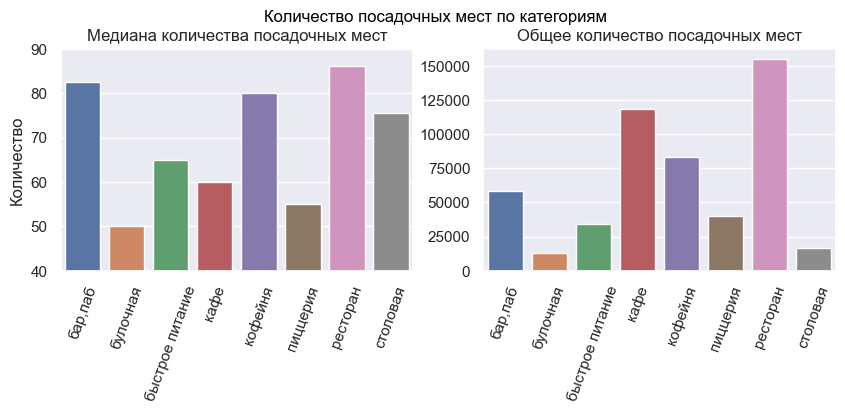

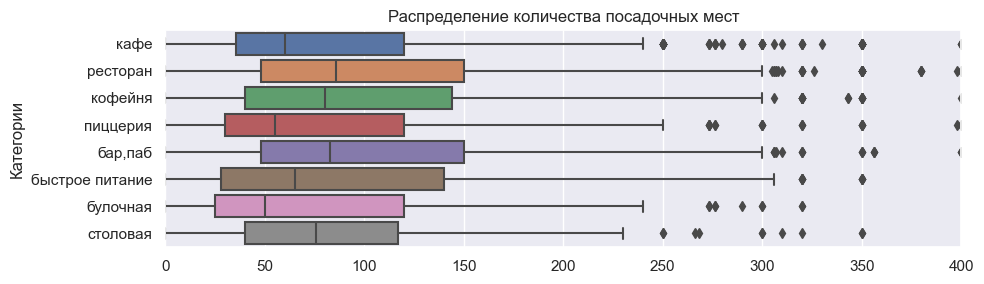

In [20]:
seats_med = mp.groupby('category', as_index=False)['seats'].agg('median')
seats_sum = mp.groupby('category', as_index=False)['seats'].agg('sum')

plt.rcParams ['figure.figsize'] = [10, 3]
plt.suptitle('Количество посадочных мест по категориям')
sns.set()
plt.subplots_adjust(top= 0.85 )

plt.subplot(1, 2, 1)
sns.barplot(y='seats', x='category', data=seats_med)
plt.xticks(rotation=70)
plt.title('Медиана количества посадочных мест')
plt.xlabel('')
plt.ylabel('Количество')
plt.ylim([40,90]);

plt.subplot(1, 2, 2)
sns.barplot(y='seats', x='category', data=seats_sum)
plt.xticks(rotation=70)
plt.title('Общее количество посадочных мест')
plt.xlabel('')
plt.ylabel('')

plt.figure(figsize=(10, 3))
sns.boxplot(x='seats', y='category', data=mp)
plt.xlim([0,400])
plt.title('Распределение количества посадочных мест')
plt.ylabel('Категории')
plt.xlabel('');

plt.tight_layout()
plt.show()

Меньше всего посадочных мест в булочных, больше всего в ресторанах, кафе и кофейнях. Среднее количество посадочных мест большинства категорий находится в диапазоне от 50 до 70.

#### Задача 3<a id="3"></a> 
* **Рассмотрите и изобразите соотношение сетевых и несетевых заведений в датасете. Каких заведений больше?**
* **Какие категории заведений чаще являются сетевыми? Исследуйте данные и ответьте на вопрос графиком.**

Построим график соотношения сетевых и не сетевых заведений в датасете.

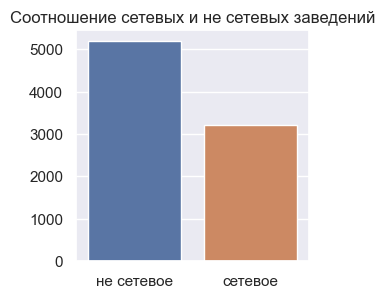

In [21]:
plt.figure(figsize=(3, 3))
sns.countplot(data=mp, x='chain')
plt.title('Соотношение сетевых и не сетевых заведений')
plt.xlabel('')
plt.ylabel('')
plt.gca().set_xticklabels(['не сетевое','сетевое']);

In [22]:
mp.groupby('chain')['name'].count().sort_values()

chain
1    3205
0    5201
Name: name, dtype: int64

Видно, что не сетевых заведений больше - около 5000, не сетевых же чуть больше чем 3000.

Сгруппируем по сетевым и не сетым заведениям, и посчитаем их процентное соотношение

In [23]:
category = mp.groupby(['category', 'chain'], \
                 as_index = False)[['category']].count()
category['chain'] = category['chain'].apply(lambda x: 'сетевое' if x == 1 else 'не сетевое')

fig = go.Figure(data=[go.Pie(labels=category['chain'],
                             values=category['category'])]) 
fig.update_layout(title='Доли сетевых и не сетевых заведений',
                  width=400, 
                  height=500,
                  annotations=[dict(x=1.12,
                                    y=1.05,
                                    text='',
                                    showarrow=False)])
fig.show()

<img src=newplot(12).png>

Сетевых заведений чуть меньше 40% а не сетевых чуть больше 60% от общего числа заведений.

Построим График соотношения сетевых и не сетевых заведений по категориям.

In [25]:
c_cat = mp.groupby(['category', 'chain'], \
                 as_index = False)[['name']].count()
c_cat = c_cat.sort_values(by='name',ascending = False)
c_cat['chain'] = c_cat['chain'].apply(lambda x: 'сетевое' if x == 1 else 'не сетевое')

fig = px.bar(c_cat.sort_values('name',ascending=True), x='name', y='category', text='name', color='chain')
fig.update_layout(title='Соотношение сетевых и не сетевых заведений по категориям',
                   xaxis_title='',
                   yaxis_title='',
                   legend_title='',
                   width=1000,
                   height=500,)
fig.show()

<img src=newplot(13).png>

Сетевых заведений в соотношении к не сетевым больше по трем категориям - булочная, пиццерия и кофейня. В остальных категориях не сетевых заведений больше.

Посчитаем процент сетевых заведений от общего числа, и построим график распределения

In [27]:
mp_pivot = mp.pivot_table(index=['category'], columns='chain', values='name', aggfunc='count')
mp_pivot['total'] = mp_pivot[1] + mp_pivot[0]
mp_pivot['ratio'] = (mp_pivot[1] / mp_pivot['total'] * 100).round(1)
mp_pivot.columns = ['not_c', 'is_c', 'total', 'ratio']
mp_pivot = mp_pivot.reset_index()

In [28]:
fig = px.bar(mp_pivot.sort_values('ratio',ascending=True), x='ratio', y='category', text='ratio')
fig.update_layout(title='Процент сетевых заведений по категориям',
                   xaxis_title='',
                   yaxis_title='',
                   legend_title='',
                   width=700,
                   height=400,)

<img src=newplot(14).png>

#### Задача 4<a id="4"></a>
* **Сгруппировать данные по названиям заведений и найти топ-15 популярных сетей в Москве(количество заведений этой сети в регионе).**
* **Построить подходящую для такой информации визуализацию. Ответить на вопросы:**
      - Знакомы ли вам эти сети?
      - Есть ли какой-то признак, который их объединяет?
      - К какой категории заведений они относятся?

Найдем топ 15 сетевых заведений по их количеству, сохраним в переменную и построим график.

In [30]:
gr_n = mp.query('chain == 1').groupby(['name','category'], \
                 as_index = False)[['rating']].count()
gr_n.columns = ['name', 'category', 'count']
gr_n = gr_n.reset_index().sort_values(by='count',ascending = False).head(15)

In [31]:
fig = px.bar(gr_n.sort_values(by='count', ascending=True), 
             x='count',
             y='name',
             text='count',
             color='category')
fig.update_layout(title='Топ-15 популярных сетей в Москве',
                   xaxis_title='Количество заведений',
                   yaxis_title='',
                   legend_title='Категории')
fig.show()

<img src=newplot(15).png>

По графику видно, что все заведения относятся к известным сетям Москвы. Больше всего заведений "Шоколадницы", меньше всего у "Drive Cafe". БОльшую часть списка занимают кофейни, на последнем месте пиццерии и одна булочная.

#### Задача 5<a id="3"></a>
* **Выяснить, какие административные районы Москвы присутствуют в датасете.**
* **Отобразить общее количество заведений и количество заведений каждой категории по районам. Проиллюстрировать эту информацию одним графиком.**

Выведем еще раз уникальные названия районов.

In [33]:
mp['district'].unique().tolist()

['Северный административный округ',
 'Северо-Восточный административный округ',
 'Северо-Западный административный округ',
 'Западный административный округ',
 'Центральный административный округ',
 'Восточный административный округ',
 'Юго-Восточный административный округ',
 'Южный административный округ',
 'Юго-Западный административный округ']

Построим график количества заведений в районах Москвы по категориям. В значениях для оси `'y'` укажем аббревиатуры районов для удобного отображения графика.

In [34]:
district = mp.groupby(['district'], \
                 as_index = False)[['name']].count()
district = district.sort_values(by='name',ascending = False)

fig = px.bar(district.sort_values('name',ascending=True), x='name', y='district', text='name')
fig.update_layout(title='Количество заведений в районах Москвы',
                   xaxis_title='',
                   yaxis_title='',
                   legend_title='',
                   width=700,
                   height=400,)

for idx in range(len(fig.data)):
    fig.data[idx].y = ['СЗАО','ЮЗАО','ЮВАО','ВАО','ЗАО','СВАО','ЮАО','САО','ЦАО']

fig.show()
    

<img src=newplot(16).png>

Видно, что самое большое количество заведений находится в центральном районе, и там же располагается наибольшее количество ресторанов, кафе и баров. В северо-западном районе находится наименьшее количество заведений всех типов. Среди остальных районов распределение количества всех категорий примерно схожее - лидируют бары, рестораны и кофейни.

Отобразим общее количество заведений и количество заведений каждой категории по районам одним графиком:

In [36]:
district = mp.groupby(['district','category'], \
                 as_index = False)[['name']].count()
district = district.sort_values(by='name',ascending = False)

fig = px.bar(district.sort_values('name',ascending=True), x='name', y='district', text='name', color='category')
fig.update_layout(title='Количество заведений в районах Москвы по категориям',
                   xaxis_title='',
                   yaxis_title='',
                   legend_title='Категории',
                   width=1000,
                   height=500,)

for idx in range(len(fig.data)):
    fig.data[idx].y = ['СЗАО','ЮЗАО','ЮВАО','ВАО','ЗАО','СВАО','ЮАО','САО','ЦАО']

fig.show()

<img src=newplot(17).png>

В центральном районе больше всего ресторанов и кафе. Столовые и булочные на последнем месте.

#### Задача 6
**Визуализировать распределение средних рейтингов по категориям заведений. Выяснить, сильно ли различаются усреднённые рейтинги в разных типах общепита.**

Построим график средних рейтингов по категориям заведений.

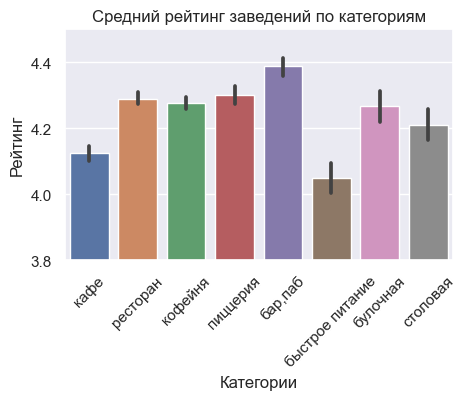

In [38]:
plt.figure(figsize=(5, 3))
sns.barplot(x='category', y='rating', data=mp)
plt.xticks(rotation=45)
plt.title('Средний рейтинг заведений по категориям')
plt.xlabel('Категории')
plt.ylabel('Рейтинг')
plt.ylim([3.8,4.5]);

Самый низкий средний рейтинг у точек быстрого питания, самый высокий у баров и пабов. В остальных категориях средние рейтинги почти на одном уровне.

#### Задача 7<a id="3"></a>
**Построить фоновую картограмму(хороплет) со средним рейтингом заведений каждого района.**

Выделим в переменную районы со средним рейтингом заведений и построим картограмму.

In [39]:
mean_rate = mp.groupby('district', as_index=False)['rating'].agg('mean').round(2)
mean_rate

,district,rating
0,Восточный административный округ,4.17
1,Западный административный округ,4.18
2,Северный административный округ,4.24
3,Северо-Восточный административный округ,4.15
4,Северо-Западный административный округ,4.21
5,Центральный административный округ,4.38
6,Юго-Восточный административный округ,4.10
7,Юго-Западный административный округ,4.17
8,Южный административный округ,4.18


In [40]:
from folium import Map, Choropleth
moscow_lat, moscow_lng = 55.751244, 37.618423

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=mean_rate,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='PuRd',
    fill_opacity='0.6',
    legend_name='Средний рейтинг заведений по районам'
).add_to(m)
m

<img src=screen1.png>

Видно, что наибольший рейтинг в центральном округе, на втором месте северный округ. Наименьшие рейтинги в юго-восточном районе. В остальных районах рейтинг заведений примерно одинаковый.

#### Задача 8<a id="8"></a>
**Отобразить все заведения датасета на карте с помощью кластеров средствами библиотеки folium.**

Построим картограмму, к названиям заведений добавим также категорию.

In [42]:
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

moscow_lat, moscow_lng = 55.751244, 37.618423
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['category']}",
    ).add_to(marker_cluster)
    
mp.apply(create_clusters, axis=1)
m

<img src=screen2.png>

#### Задача 9<a id="9"></a>
* **Найти топ-15 улиц по количеству заведений.** 
* **Построить график распределения количества заведений и их категорий по этим улицам. Проиллюстрировать эту информацию одним графиком.**

<div class="alert alert-info">
<b>Комментарий студента:</b>
<br>Во время изучения результатов фильтрации я заметила, что на нескольких улицах находится одинаковое количество заведений - 18, и получается так, что они делят последнее место. Если выводить график вместе с ними, это будет противоречить условию задания "Найдите топ-15 улиц..", и я решила оставить так как есть.
</div>

Найдём топ-15 улиц по количеству заведений и построим график:

In [44]:
gr_str = mp.groupby(['street'], \
                 as_index = False)[['name']].count()
gr_str = gr_str.sort_values(by='name',ascending = False).head(15)

In [45]:
fig = px.bar(gr_str.sort_values('name',ascending=True), x='name', y='street', text='name')
fig.update_layout(title='Топ 15 улиц по количеству заведений',
                   xaxis_title='',
                   yaxis_title='',
                   legend_title='',
                   width=700,
                   height=500,)
fig.show() 

<img src=newplot(18).png>

Наибольшее общее количество заведений находится на проспекте Мира, и больше всего там кафе и ресторанов. Далее идет Ленинский проспект с ресторанами, кафе и кофейнями. Последнее место делят Новоясеневский проспект и Пресненская набережная.

#### Задача 10<a id="10"></a>
**Найти улицы, на которых находится только один объект общепита. Что можно сказать об этих заведениях?**

Сохраним информацию о одинственных заведениях на улицах

In [47]:
one = mp.groupby('street').count()
one = one.query('address == 1').reset_index()
only = list(one['street'])
only = mp[mp['street'].isin(only)]
only.shape

(458, 16)

In [48]:
only.groupby('category')['name'].count().sort_values(ascending=False)

category
кафе               160
ресторан            93
кофейня             84
бар,паб             39
столовая            36
быстрое питание     23
пиццерия            15
булочная             8
Name: name, dtype: int64

Вышла довольно длинная таблица. Больше всего  заведений категории кафе. Посмотрим на расположение заведений на карте:

In [49]:
moscow_lat, moscow_lng = 55.751244, 37.618423
one = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(one)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['category']}",
    ).add_to(marker_cluster)
    
only.apply(create_clusters, axis=1)
one

<img src=screen3.png>

Больше всего улиц с одним заведением находится в центре, остальные точки встречаются у парков, кладбищ и промзон.

#### Задача 11<a id="11"></a>
* **Посчитать медиану этого столбца для каждого района, использовать это значение в качестве ценового индикатора района.**
* **Построить фоновую картограмму (хороплет) с полученными значениями для каждого района. Проанализировать цены в центральном административном округе и других. Предположить, как удалённость от центра влияет на цены в заведениях.**

In [51]:
mean_price = mp.groupby('district', as_index=False)['middle_avg_bill'].agg('median').round()
mean_price

,district,middle_avg_bill
0,Восточный административный округ,575.0
1,Западный административный округ,1000.0
2,Северный административный округ,650.0
3,Северо-Восточный административный округ,500.0
4,Северо-Западный административный округ,700.0
5,Центральный административный округ,1000.0
6,Юго-Восточный административный округ,450.0
7,Юго-Западный административный округ,600.0
8,Южный административный округ,500.0


In [52]:

moscow_lat, moscow_lng = 55.751244, 37.618423

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=mean_price,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='PuBuGn',
    fill_opacity='0.6',
    legend_name='Медиана средних цен по районам'
).add_to(m)

m

<img src=screen4.png>

Посмотрим на взаимосвязь рейтинга и среднего чека заведения

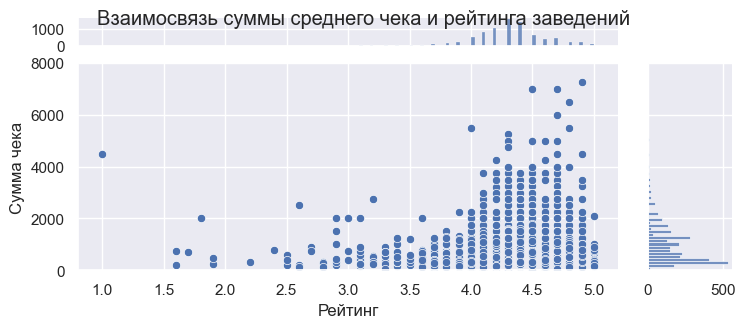

In [54]:
p = sns.jointplot(x='rating', y ='middle_avg_bill', data=mp, ylim=(0,8000),  ratio=5, marginal_ticks=True)
p.fig.suptitle('Взаимосвязь суммы среднего чека и рейтинга заведений')
p.fig.tight_layout()
p.fig.set_figwidth(8)
p.fig.set_figheight(3)
p.fig.subplots_adjust(top=0.95)
p.ax_joint.set_xlabel('Рейтинг')
p.ax_joint.set_ylabel('Сумма чека')
plt.show();

Видно, что чем выше рейтинг заведения, тем выше сумма среднего чека.

#### Задача 12<a id="12"></a>
**Вывод**

Мы проанализировали датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года, построили графики и картограммы, и сделали несколько выводов о полученной информации:

* Подсчет количества заведений по категориям показал, что больше всего в Москве заведений, относящихся к категории кафе. Это может быть обусловлено тем, что понятие кафе как заведение довольно размыто, в эту категорию можно отнести довольно много разнообразных мест общественного питания, в том числе и кофейни. На втором месте по количеству заведений кофейни. Не удивительно, в Москве они на каждом шагу. На последнем месте столовые и булочные. Малое количество столовых возможно обусловлено тем, что сейчас это уже пережиток прошлого и особой популярностью у населения не пользуются. Булочные так же могут оказаться в категории кофеен, и там и там часто продают и выпечку и кофе. 


* По количеству посадочных мест в общем по Москве лидируют рестораны, и это очевидно - ресторан сам по себе подразумевает наличие сидячего места, в отличие от баров. На втором месте кафе, под которым может иметься все что угодно, от кальянной до бистро. Точки быстрого питания обычно не имеют посадочных мест, как и булочные, этим обусловлено то что они на последнем месте. 


* Не сетевых заведений больше по отношению к сетевым почти в половину. Сетевых заведений в соотношении к не сетевым больше по трем категориям - булочная, пиццерия и кофейня. В остальных категориях не сетевых заведений больше.


* Мы нашли топ 15 популярных сетевых заведений в Москве. Лидирует по количеству заведений Шоколадница. Самые часто встречающиеся пиццерии это Додо пицца и Доминос. Больше всего точек среди ресторанов у Яндекс Лавки. Скорее всего, это пункты сбора заказов, а в этой категории она оказалось потому что осуществляет доставку из ресторанов Москвы. В конце списка единственная булочная - Буханка - 25 точек в Москве.


* В датасете присутствуют все административные районы Москвы. Самое большое количество заведений находится в центральном районе, и там же располагается наибольшее количество ресторанов, кафе и баров. В северо-западном районе находится наименьшее количество заведений всех типов. Среди остальных районов распределение количества всех категорий примерно схожее - лидируют бары, рестораны и кофейни.


* График распределения средних рейтингов по категориям показал, что самый низкий средний рейтинг у точек быстрого питания, и это очевидно. Самый высокий у баров и пабов - тоже не удивительно, люди ставят хорошие рейтинги чаще в заведениях где отдыхают и развлекаются. В остальных категориях средние рейтинги почти на одном уровне.


* Отображение средних рейтингов по районам на карте помогло понять, что выше всего рейтинги в Центральном районе. Это естественно, в центре и количество заведений больше, и качество оказываемого обслуживания выше.


* Мы нашли топ 15 улиц по количеству заведений. На первом месте проспект Мира - более 150 заведений, на втором Ленинский - примерно 80. Это одни из самых длиннных улиц Москвы (9км и 14км). На последнем месте Пресненская набережная - короткая улица, для которой и 18 заведений это много, но она находится в "Москва-Сити", это всё объясняет.


* Мы нашли улицы, где находится всего одно заведение. В основном эти точки сосредоточены в центре города, где много маленьких улиц и переулков. В большей отдалённости от центра улицы с одним заведением находятся возле парков, кладбищ и промзон.


* Отображение средних цен по районам показало, что самые высокие цены в Центральном округе, что очевидно, и в Западном административном округе, вероятно, из-за соседства с Деловым центром, наличием в этом округе аэропорта, вокзала, здания МГУ и в целом высокой стоимости аренды.


* Мы нашли взаимосвязь среднего чека и рейтинга заведения - очевидно, что чем высокий рейтинг заведения говорит о качественном обслуживании, и соответственно, о более высоких ценах.

## Открытие Кофейни<a id="coffee"></a>

* **Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?**
* **Есть ли круглосуточные кофейни?**
* **Какие у кофеен рейтинги? Как они распределяются по районам?**
* **На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?**

**Количество кофеен, количество кофеен по районам и особенности их расположения**<a id="с1"></a>

Сделаем срез со всеми кофейнями датасета и выведем количество получившихся строк.

In [55]:
coffee = mp.query('category == "кофейня"')
coffee.shape

(1413, 16)

1413 кофеен. Сгруппируем их по районам и выведем их количество.

In [56]:
bean = coffee.groupby(['district'], \
                 as_index = False)[['name']].count()
bean = bean.sort_values(by='name',ascending = False)

In [57]:
fig = px.bar(bean.sort_values('name'), x='name', y='district', text='name')
fig.update_layout(title='Количество кофеен в районах Москвы',
                   xaxis_title='',
                   yaxis_title='',
                   legend_title='',
                   width=700,
                   height=500,)

for idx in range(len(fig.data)):
    fig.data[idx].y = ['СЗАО','ЮВАО','ЮЗАО','ВАО','ЮАО','ЗАО','СВАО','САО','ЦАО']
fig.show() 

<img src=newplot(19).png>

Больше всего кофеен в Центральном районе, меньше всего - в Северо-Западном.

Попробуем понять особенности расположения кофеен, отобразив их на карте.

In [59]:
moscow_lat, moscow_lng = 55.751244, 37.618423
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)
    
coffee.apply(create_clusters, axis=1)
m

<img src=screen5.png>

В основном кофейни располагаются у метро и вокзалов, в местах большого скопления народа.

**Круглосуточные кофейни**<a id="с2"></a>

Найдем количество круглосуточных кофеен по районам.

In [61]:
c_24 = coffee.loc[coffee['is_24/7'] == True].groupby(['district'], as_index=False)[['name']].count()
display(c_24.sort_values('name', ascending=False))

,district,name
5,Центральный административный округ,38
1,Западный административный округ,11
7,Юго-Западный административный округ,7
2,Северный административный округ,6
0,Восточный административный округ,5
3,Северо-Восточный административный округ,4
4,Северо-Западный административный округ,3
6,Юго-Восточный административный округ,1
8,Южный административный округ,1


Круглосуточных кофеен в общем мало, и они в основном расположены в Центральном районе, там и вокзалы, и ночная жизнь.

**Рейтинги и их распределение по районам**<a id="с3"></a>

Получим средние рейтинги по районам и выведем их на карте для наглядности.

In [62]:
coffee_rating = coffee.groupby('district', as_index=False)['rating'].agg('mean')
display(coffee_rating)

,district,rating
0,Восточный административный округ,4.282857
1,Западный административный округ,4.195333
2,Северный административный округ,4.291710
3,Северо-Восточный административный округ,4.216981
4,Северо-Западный административный округ,4.325806
5,Центральный административный округ,4.336449
6,Юго-Восточный административный округ,4.225843
7,Юго-Западный административный округ,4.283333
8,Южный административный округ,4.232824


In [63]:
moscow_lat, moscow_lng = 55.751244, 37.618423

m3 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=coffee_rating,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='RdPu',
    fill_opacity='0.6',
    
    legend_name='Рейтинги кофеен по районам'
).add_to(m3)

m3

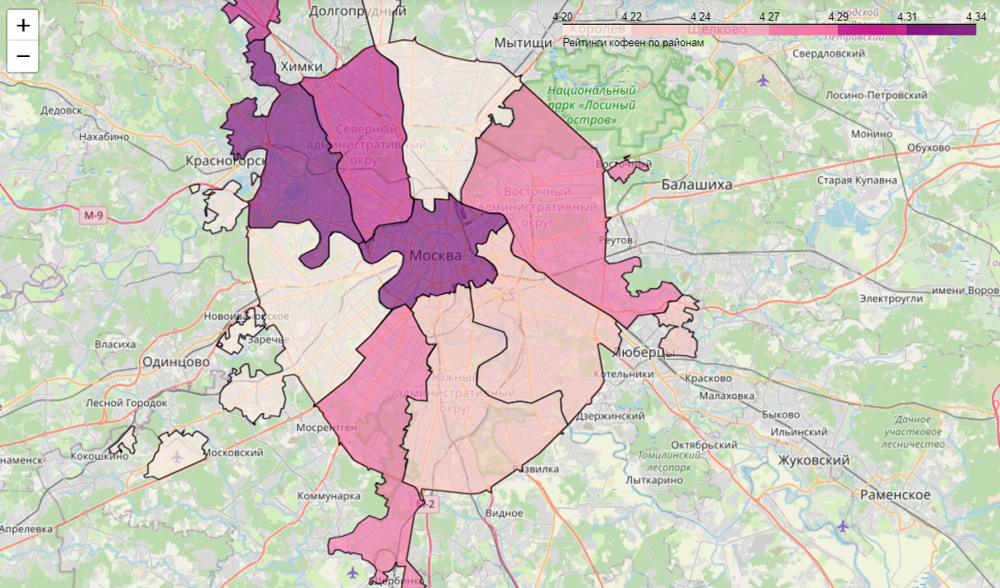

In [64]:
Image(filename='C:\\Users\\admin\\Downloads\\Practicum\\Projects\\6_restaurants_analysis\\screen6.png')

В целом рейтинги не сильно отличаются - все в районе 4. Выше всего эти показатели в Центральном и Северо-Западном районе, ниже всего в Западном и Северо-Восточном. 

**Средняя стоимость чашки кофе по районам**<a id="с4"></a>

In [65]:
coffee['middle_coffee_cup'].describe()

count     521.000000
mean      175.055662
std        89.753009
min        60.000000
25%       124.000000
50%       170.000000
75%       225.000000
max      1568.000000
Name: middle_coffee_cup, dtype: float64

По Москве минимальная стоимость чашки кофе - 60р, максимальная - 1568р. 

Выведем среднюю стоимость чашки по районам.

In [66]:
mean_coffee = coffee.groupby('district', as_index=False)['middle_coffee_cup'].agg('median')

fig = px.bar(mean_coffee.sort_values('middle_coffee_cup'), x='middle_coffee_cup', y='district', text='middle_coffee_cup')
fig.update_layout(title='Средняя стоимость чашки кофе по районам',
                   xaxis_title='',
                   yaxis_title='',
                   legend_title='',
                   width=700,
                   height=400,)

for idx in range(len(fig.data)):
    fig.data[idx].y = ['ВАО','ЮВАО','ЮАО','САО','СВАО','СЗАО','ЗАО','ЦАО','ЮЗАО']
fig.show()

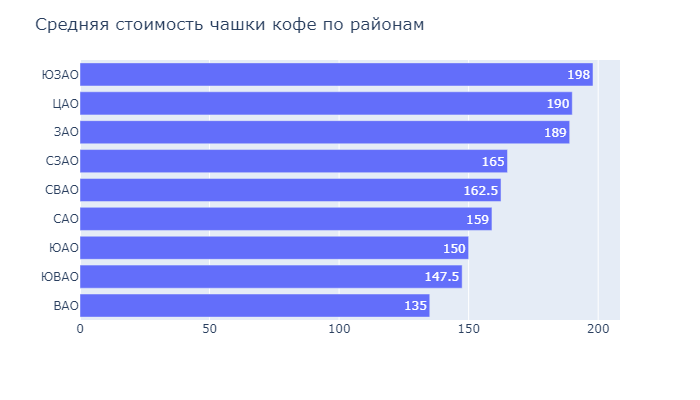

In [67]:
Image(filename='C:\\Users\\admin\\Downloads\\Practicum\\Projects\\6_restaurants_analysis\\newplot(20).png')

В Юго-Западном районе средняя цена чашки самая высокая - 198р. Немногим меньше цены в Центральном и Западном районе. На втором месте следущая тройка - СЗАО, СВАО и САО. В остальных районах средняя цена чашки кофе ниже всего.

In [68]:
moscow_lat, moscow_lng = 55.751244, 37.618423

m3 = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=state_geo,
    data=mean_coffee,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='YlGnBu',
    fill_opacity='0.6',
    
    legend_name='Средняя цена чашки кофе по районам'
).add_to(m3)

m3

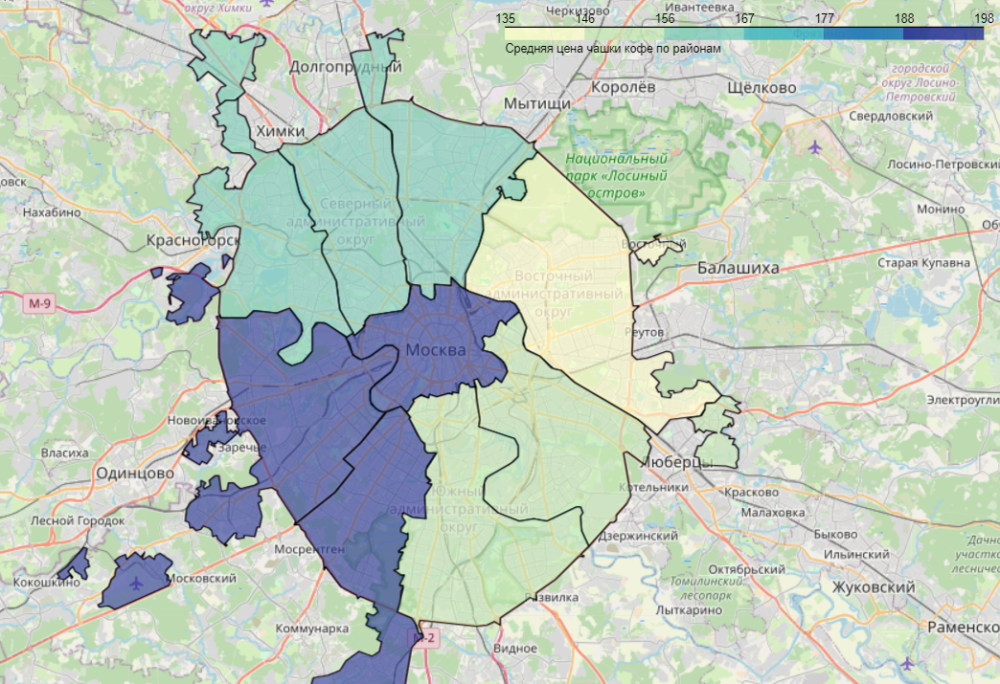

In [69]:
Image(filename='C:\\Users\\admin\\Downloads\\Practicum\\Projects\\6_restaurants_analysis\\screen7.png')

* Кофейни входят в тройку самых популярных заведений Москвы, и для открытия новой точки не потребуется так много вложений, как в кафе или ресторан.

* Наибольшее количество кофеен находится в Центральном округе москвы, а наименьшее - в Северо-Западном, где не будет  конкуренции.

* Для открытия кофейни в Центральном районе, стоит ориентироваться на цену чашки кофе чуть ниже средней, чтобы повысить конкурентоспособность точки.

* Для открытия кофейни в Северо-Западном районе, можно установить стоимость чашки кофе чуть выше средней по району, ведь в округе всего 62 кофейни, и какая-либо конкуренция будет не ощутима.

## Презентация<a id="presentation"></a>

Презентация: <https://docs.google.com/presentation/d/1Th2sxdTwiExbHddnK0-mD3ibVbHmpigpskehpjSU22o/edit?usp=sharing> 